In [1]:
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
import seaborn as sns
import os
from mpl_toolkits.mplot3d import axes3d

In [2]:
filename_in_dir = []

for root, dirs, files in os.walk('csv'):
    for  fname in files:
        full_fname = os.path.join(root, fname)
        filename_in_dir.append(full_fname)
print(len(filename_in_dir))

109


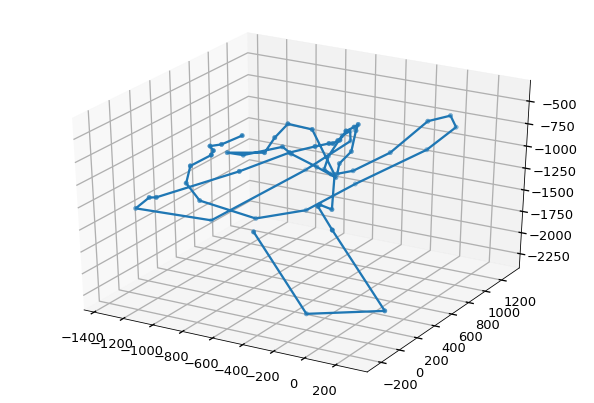

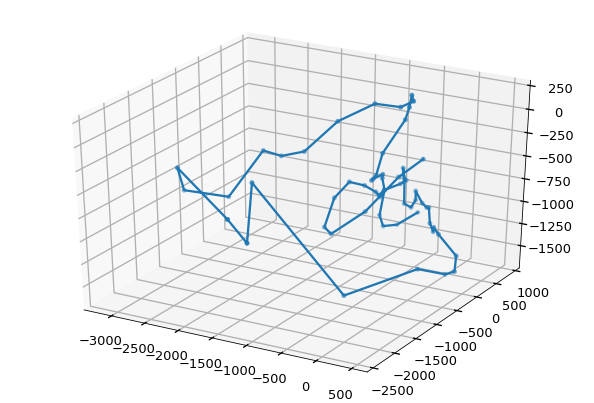

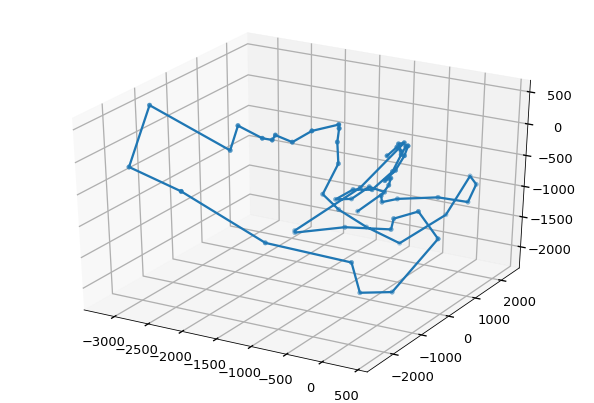

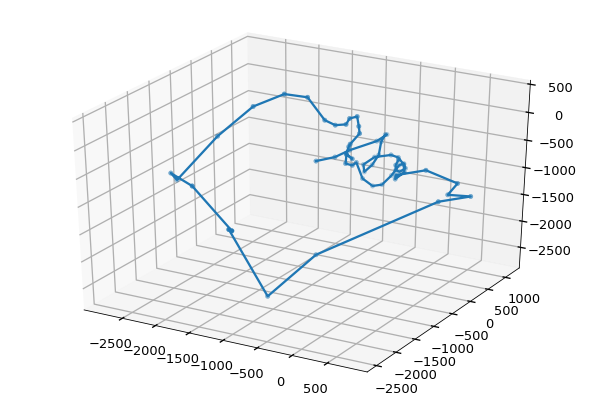

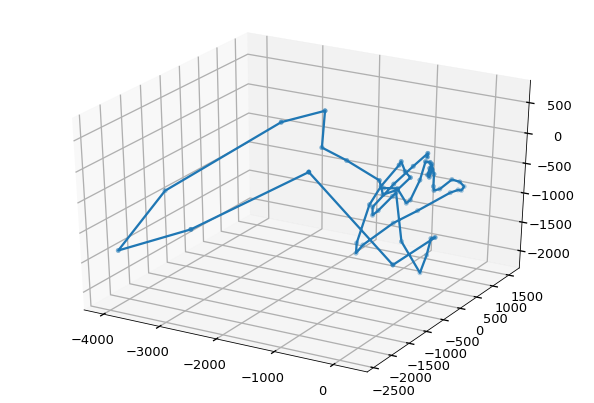

...

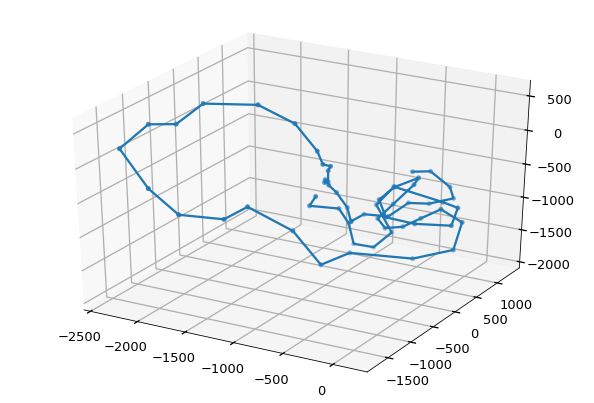

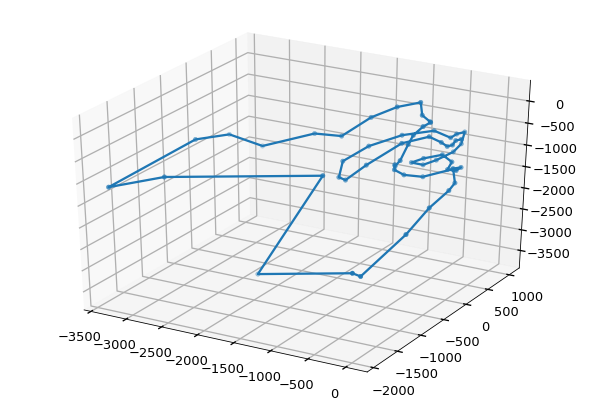

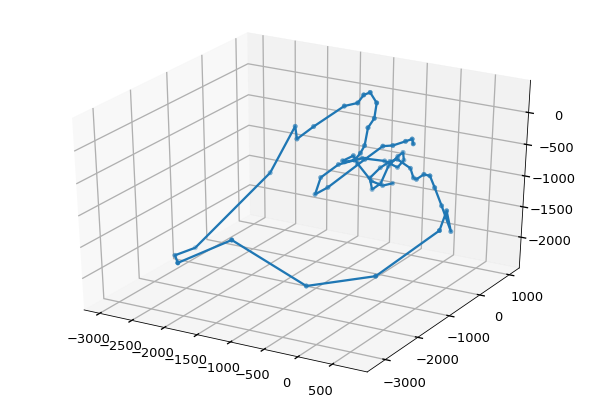

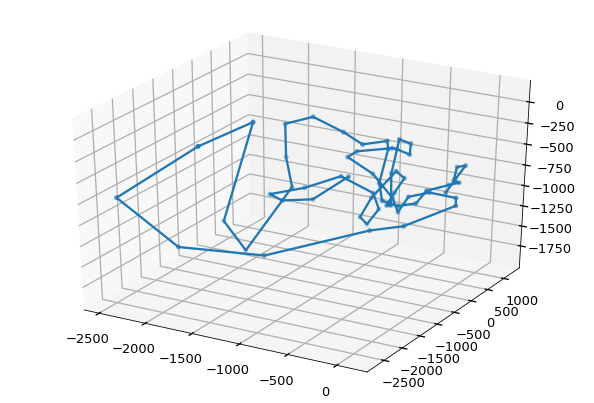

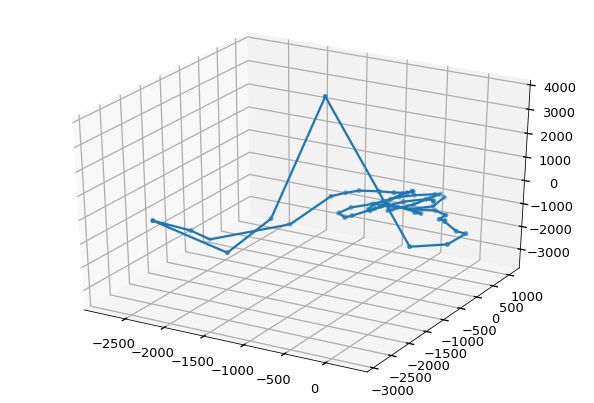

In [3]:
for x in filename_in_dir:
    f = open(x,'r')
    d = f.read()
    data = d.split('\n')
    data.pop(0)
    index = data.pop(0)
    real_data = []
    for y in range(len(data)):
        if data[y]=='':
            continue
        real_data.append(data[y].split(','))
    df = pd.DataFrame(real_data)
    index_li = index.split(',')
    df.columns = index_li
    for y in index_li:
        df[y] = pd.to_numeric(df[y],downcast='float')
    plt.style.use('seaborn-talk')
    fig = plt.figure()
    ax = fig.add_subplot(111,projection='3d')
    X = np.array(df['AX'])
    Y = np.array(df['AY'])
    Z = np.array(df['AZ'])
    ax.scatter(X,Y,Z)
    ax.plot(X,Y,Z)
    plt.show()

In [4]:
df

,AX,AY,AZ,GX,GY,GZ,speed,degree,piezoo,degreez
0,-366.0,1043.0,-1028.0,449.0,0.0,246.0,1405.0,131.0,0.0,436.0
1,-374.0,729.0,-1150.0,305.0,0.0,237.0,1356.0,130.0,0.0,438.0
2,-559.0,526.0,-1203.0,114.0,0.0,313.0,1290.0,130.0,0.0,440.0
3,-977.0,411.0,-1162.0,-167.0,0.0,138.0,1290.0,130.0,0.0,440.0
4,-960.0,187.0,-1167.0,-311.0,0.0,-81.0,959.0,129.0,0.0,443.0
5,-878.0,50.0,-1067.0,-351.0,0.0,-105.0,959.0,129.0,0.0,443.0
6,-746.0,59.0,-790.0,-206.0,0.0,132.0,775.0,128.0,0.0,445.0
7,-637.0,1.0,-540.0,141.0,0.0,406.0,720.0,127.0,0.0,446.0
8,-709.0,13.0,-528.0,589.0,0.0,657.0,680.0,126.0,0.0,449.0
9,-628.0,60.0,-407.0,709.0,0.0,613.0,615.0,126.0,0.0,451.0


In [5]:
import math
pi = 3.1415926535
df['pitch'] = 180 * np.arctan(df['AX']/np.sqrt(df['AY']*df['AY']+df['AZ']*df['AZ']))/pi
df['roll'] = 180 * np.arctan(df['AY']/np.sqrt(df['AX']*df['AX']+df['AZ']*df['AZ']))/pi
df['yaw'] = 180 * np.arctan(df['AZ']/np.sqrt(df['AY']*df['AY']+df['AX']*df['AX']))/pi

In [6]:
df

,AX,AY,AZ,GX,GY,GZ,speed,degree,piezoo,degreez,pitch,roll,yaw
0,-366.0,1043.0,-1028.0,449.0,0.0,246.0,1405.0,131.0,0.0,436.0,-14.032040,43.705948,-42.923431
1,-374.0,729.0,-1150.0,305.0,0.0,237.0,1356.0,130.0,0.0,438.0,-15.359090,31.083017,-54.531300
2,-559.0,526.0,-1203.0,114.0,0.0,313.0,1290.0,130.0,0.0,440.0,-23.062023,21.629433,-57.460377
3,-977.0,411.0,-1162.0,-167.0,0.0,138.0,1290.0,130.0,0.0,440.0,-38.402786,15.148265,-47.630199
4,-960.0,187.0,-1167.0,-311.0,0.0,-81.0,959.0,129.0,0.0,443.0,-39.085579,7.054438,-50.034180
5,-878.0,50.0,-1067.0,-351.0,0.0,-105.0,959.0,129.0,0.0,443.0,-39.419037,2.072325,-50.504616
6,-746.0,59.0,-790.0,-206.0,0.0,132.0,775.0,128.0,0.0,445.0,-43.279629,3.108093,-46.551655
7,-637.0,1.0,-540.0,141.0,0.0,406.0,720.0,127.0,0.0,446.0,-49.711216,0.068611,-40.288700
8,-709.0,13.0,-528.0,589.0,0.0,657.0,680.0,126.0,0.0,449.0,-53.316223,0.842519,-36.670841
9,-628.0,60.0,-407.0,709.0,0.0,613.0,615.0,126.0,0.0,451.0,-56.771442,4.583941,-32.828136


In [7]:
df['x'] = np.cos(df['yaw'])*np.cos(df['pitch'])
df['y'] = np.sin(df['yaw'])*np.cos(df['pitch'])
df['z'] = np.sin(df['pitch'])

In [8]:
df

,AX,AY,AZ,GX,GY,GZ,speed,degree,piezoo,degreez,pitch,roll,yaw,x,y,z
0,-366.0,1043.0,-1028.0,449.0,0.0,246.0,1405.0,131.0,0.0,436.0,-14.032040,43.705948,-42.923431,0.051403,0.091481,-0.994479
1,-374.0,729.0,-1150.0,305.0,0.0,237.0,1356.0,130.0,0.0,438.0,-15.359090,31.083017,-54.531300,0.405859,-0.847599,-0.341839
2,-559.0,526.0,-1203.0,114.0,0.0,313.0,1290.0,130.0,0.0,440.0,-23.062023,21.629433,-57.460377,-0.293556,0.378956,0.877620
3,-977.0,411.0,-1162.0,-167.0,0.0,138.0,1290.0,130.0,0.0,440.0,-38.402786,15.148265,-47.630199,-0.666811,0.369762,-0.647024
4,-960.0,187.0,-1167.0,-311.0,0.0,-81.0,959.0,129.0,0.0,443.0,-39.085579,7.054438,-50.034180,0.178406,0.042018,-0.983059
5,-878.0,50.0,-1067.0,-351.0,0.0,-105.0,959.0,129.0,0.0,443.0,-39.419037,2.072325,-50.504616,-0.144349,0.035192,-0.988901
6,-746.0,59.0,-790.0,-206.0,0.0,132.0,775.0,128.0,0.0,445.0,-43.279629,3.108093,-46.551655,-0.641550,-0.413239,0.646256
7,-637.0,1.0,-540.0,141.0,0.0,406.0,720.0,127.0,0.0,446.0,-49.711216,0.068611,-40.288700,-0.723998,-0.445886,0.526320
8,-709.0,13.0,-528.0,589.0,0.0,657.0,680.0,126.0,0.0,449.0,-53.316223,0.842519,-36.670841,-0.514171,-0.852875,-0.090727
9,-628.0,60.0,-407.0,709.0,0.0,613.0,615.0,126.0,0.0,451.0,-56.771442,4.583941,-32.828136,0.154020,-0.963050,-0.220937


In [9]:
point_x = []
point_y = []
point_z = []
x = 0
y = 0
z = 0

for i in range(len(df)):
    length = df['speed'][i] ** (1.0/3.0)
    x += df['x'][i] * length
    y += df['y'][i] * length
    z += df['z'][i] * length
    point_x.append(x)
    point_y.append(y)
    point_z.append(z)

df['mx'] = point_x
df['my'] = point_y
df['mz'] = point_z   

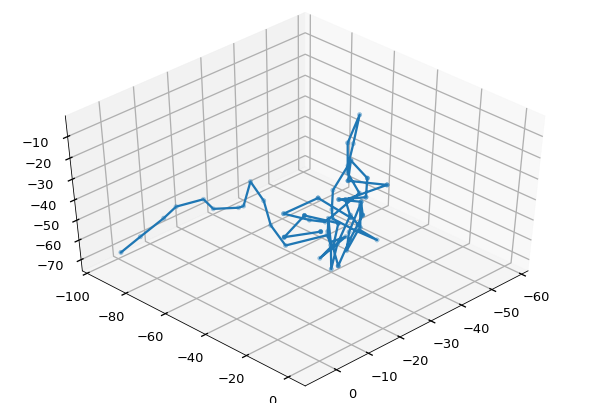

In [10]:
plt.style.use('seaborn-talk')
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
X = np.array(df['mx'])
Y = np.array(df['my'])
Z = np.array(df['mz'])
ax.scatter(X,Y,Z)
ax.plot(X,Y,Z)
ax.view_init(45, 45)
plt.show()

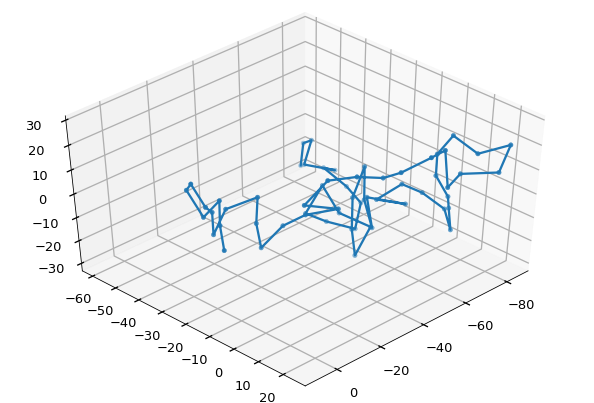

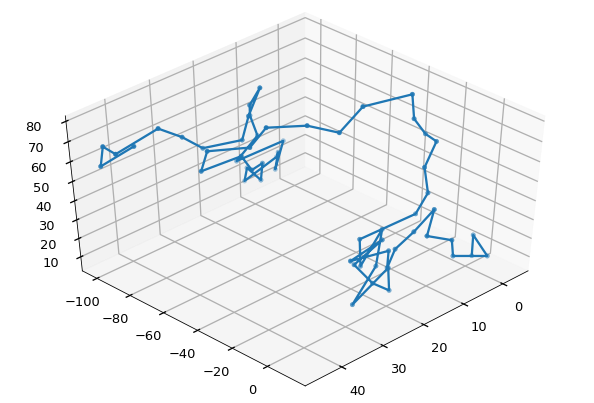

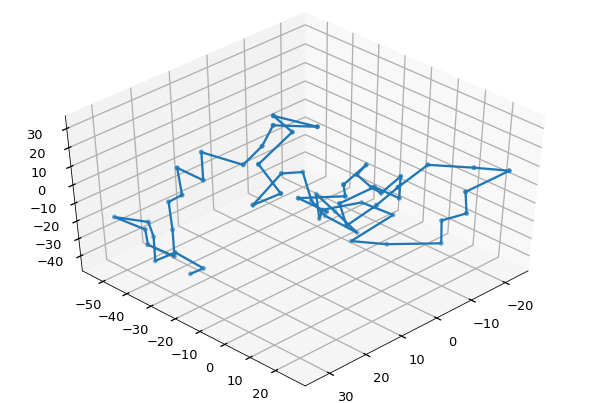

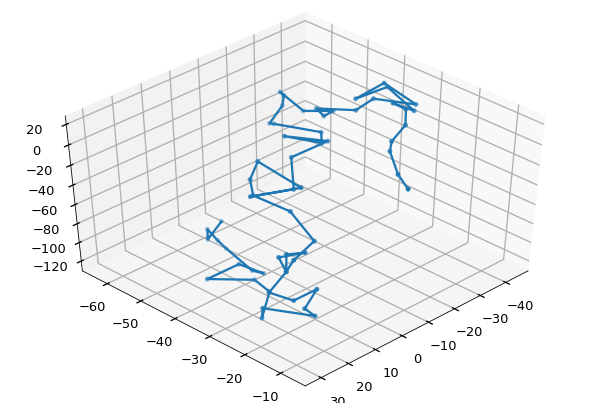

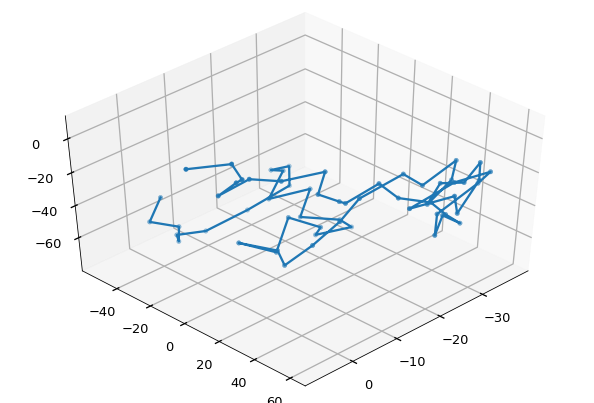

...

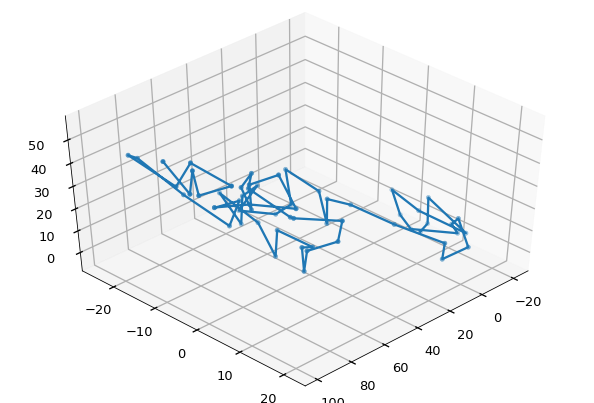

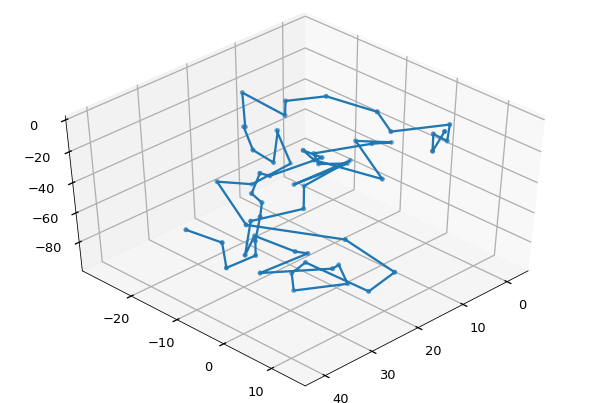

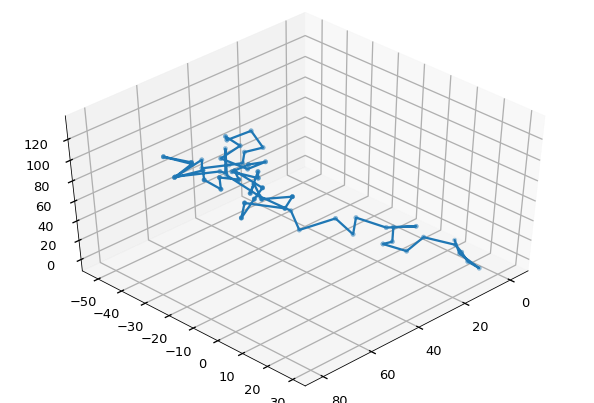

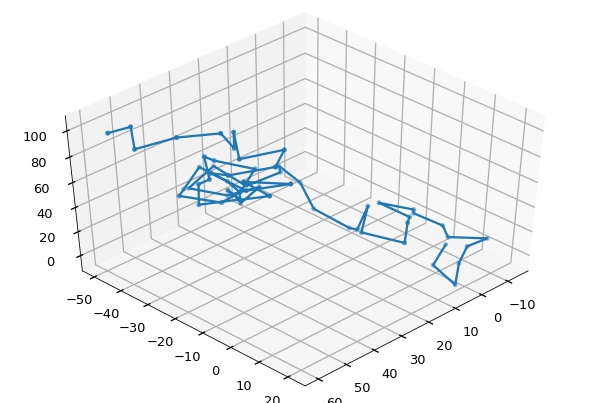

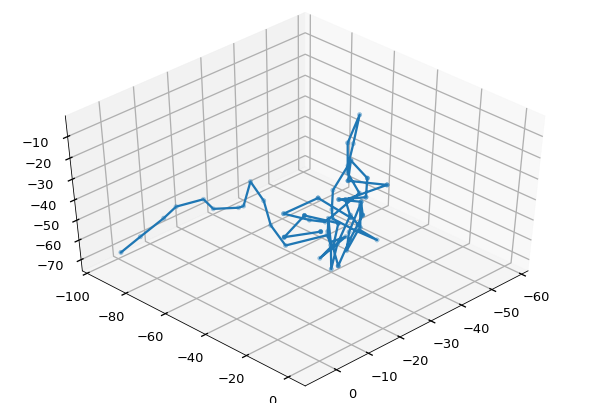

In [11]:
for x in filename_in_dir:
    f = open(x,'r')
    d = f.read()
    data = d.split('\n')
    data.pop(0)
    index = data.pop(0)
    real_data = []
    for y in range(len(data)):
        if data[y]=='':
            continue
        real_data.append(data[y].split(','))
    df = pd.DataFrame(real_data)
    index_li = index.split(',')
    df.columns = index_li
    for y in index_li:
        df[y] = pd.to_numeric(df[y],downcast='float')
    
    pi = 3.1415926535
    df['pitch'] = 180 * np.arctan(df['AX']/np.sqrt(df['AY']*df['AY']+df['AZ']*df['AZ']))/pi
    df['roll'] = 180 * np.arctan(df['AY']/np.sqrt(df['AX']*df['AX']+df['AZ']*df['AZ']))/pi
    df['yaw'] = 180 * np.arctan(df['AZ']/np.sqrt(df['AY']*df['AY']+df['AX']*df['AX']))/pi
    df['x'] = np.cos(df['yaw'])*np.cos(df['pitch'])
    df['y'] = np.sin(df['yaw'])*np.cos(df['pitch'])
    df['z'] = np.sin(df['pitch'])

    point_x = []
    point_y = []
    point_z = []
    x = 0
    y = 0
    z = 0

    for i in range(len(df)):
        length = df['speed'][i] ** (1.0/3.0)
        x += df['x'][i] * length
        y += df['y'][i] * length
        z += df['z'][i] * length
        point_x.append(x)
        point_y.append(y)
        point_z.append(z)

    df['mx'] = point_x
    df['my'] = point_y
    df['mz'] = point_z   
    
    plt.style.use('seaborn-talk')
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    X = np.array(df['mx'])
    Y = np.array(df['my'])
    Z = np.array(df['mz'])
    ax.scatter(X,Y,Z)
    ax.plot(X,Y,Z)
    ax.view_init(45, 45)
    plt.show()

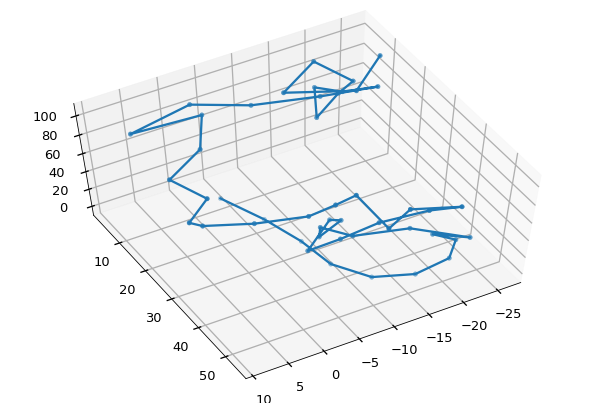

In [12]:
f = open('sample.txt','r')
d = f.read()
data = d.split('\n')
index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
real_data = []
for y in range(len(data)):
    if data[y]=='':
        continue
    real_data.append(data[y].split(','))
df = pd.DataFrame(real_data)
df.columns = index_li
for y in index_li:
    df[y] = pd.to_numeric(df[y],downcast='float')

pi = 3.1415926535
df['pitch'] = 180 * np.arctan(df['AX']/np.sqrt(df['AY']*df['AY']+df['AZ']*df['AZ']))/pi
df['roll'] = 180 * np.arctan(df['AY']/np.sqrt(df['AX']*df['AX']+df['AZ']*df['AZ']))/pi
df['yaw'] = 180 * np.arctan(df['AZ']/np.sqrt(df['AY']*df['AY']+df['AX']*df['AX']))/pi
df['x'] = np.cos(df['yaw'])*np.cos(df['pitch'])
df['y'] = np.sin(df['yaw'])*np.cos(df['pitch'])
df['z'] = np.sin(df['pitch'])
df['speed'] = np.sqrt(df['AX']*df['AX']+df['AY']*df['AY']+df['AZ']*df['AZ'])

point_x = []
point_y = []
point_z = []
x = 0
y = 0
z = 0

for i in range(len(df)):
    length = df['speed'][i] ** (1.0/3.0)
    x += df['x'][i] * length
    y += df['y'][i] * length
    z += df['z'][i] * length
    point_x.append(x)
    point_y.append(y)
    point_z.append(z)

df['mx'] = point_x
df['my'] = point_y
df['mz'] = point_z   

plt.style.use('seaborn-talk')
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
X = np.array(df['mx'])
Y = np.array(df['my'])
Z = np.array(df['mz'])
ax.scatter(X,Y,Z)
ax.plot(X,Y,Z)
ax.view_init(60, 60)
plt.show()

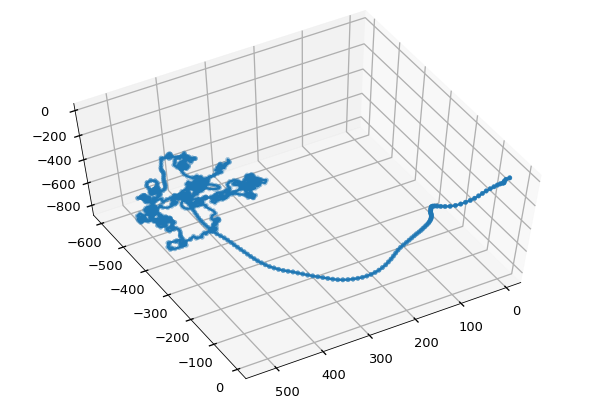

In [13]:
f = open('0104serial.txt','r')
d = f.read()
data = d.split('\n')
index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
real_data = []
for y in range(len(data)):
    if data[y]=='':
        continue
    real_data.append(data[y].split(','))
df = pd.DataFrame(real_data)
df.columns = index_li
for y in index_li:
    df[y] = pd.to_numeric(df[y],downcast='float')

pi = 3.1415926535
df['pitch'] = 180 * np.arctan(df['AX']/np.sqrt(df['AY']*df['AY']+df['AZ']*df['AZ']))/pi
df['roll'] = 180 * np.arctan(df['AY']/np.sqrt(df['AX']*df['AX']+df['AZ']*df['AZ']))/pi
df['yaw'] = 180 * np.arctan(df['AZ']/np.sqrt(df['AY']*df['AY']+df['AX']*df['AX']))/pi
df['x'] = np.cos(df['yaw'])*np.cos(df['pitch'])
df['y'] = np.sin(df['yaw'])*np.cos(df['pitch'])
df['z'] = np.sin(df['pitch'])
df['speed'] = np.sqrt(df['AX']*df['AX']+df['AY']*df['AY']+df['AZ']*df['AZ'])

point_x = []
point_y = []
point_z = []
x = 0
y = 0
z = 0

for i in range(len(df)):
    length = df['speed'][i] ** (1.0/3.0)
    x += df['x'][i] * length
    y += df['y'][i] * length
    z += df['z'][i] * length
    point_x.append(x)
    point_y.append(y)
    point_z.append(z)

df['mx'] = point_x
df['my'] = point_y
df['mz'] = point_z   

plt.style.use('seaborn-talk')
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
X = np.array(df['mx'])
Y = np.array(df['my'])
Z = np.array(df['mz'])
ax.scatter(X,Y,Z)
ax.plot(X,Y,Z)
ax.view_init(60, 60)
plt.show()

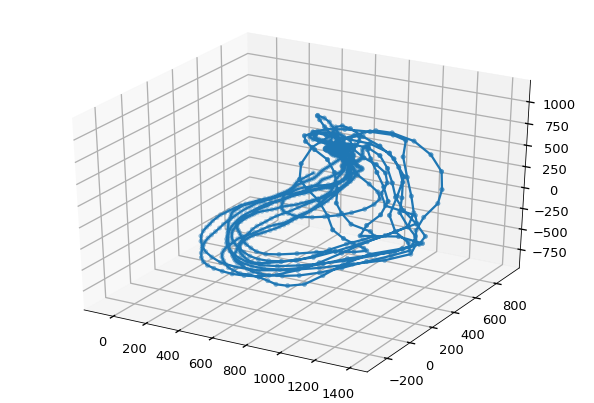

In [14]:
f = open('0104serial.txt','r')
d = f.read()
data = d.split('\n')
index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
real_data = []
for y in range(len(data)):
    if data[y]=='':
        continue
    real_data.append(data[y].split(','))
df = pd.DataFrame(real_data)
df.columns = index_li
for y in index_li:
    df[y] = pd.to_numeric(df[y],downcast='float')

plt.style.use('seaborn-talk')

fig = plt.figure()
ax = fig.add_subplot(111,projection='3d')
X = np.array(df['AX'])
Y = np.array(df['AY'])
Z = np.array(df['AZ'])
ax.scatter(X,Y,Z)
ax.plot(X,Y,Z)
plt.show()

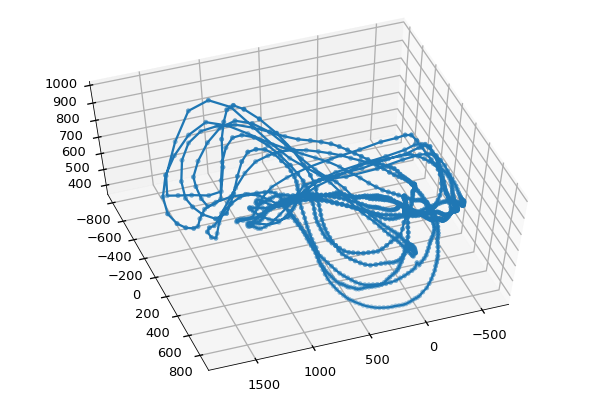

In [15]:
f = open('0104-2.txt','r')
d = f.read()
data = d.split('\n')
index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
real_data = []
for y in range(len(data)):
    if data[y]=='':
        continue
    real_data.append(data[y].split(','))
df = pd.DataFrame(real_data)
df.columns = index_li
for y in index_li:
    df[y] = pd.to_numeric(df[y],downcast='float')

plt.style.use('seaborn-talk')

fig = plt.figure()
ax = fig.add_subplot(111,projection='3d')
X = np.array(df['AX'])
Y = np.array(df['AY'])
Z = np.array(df['AZ'])
ax.scatter(X,Y,Z)
ax.plot(X,Y,Z)
ax.view_init(60, 70)
plt.show()

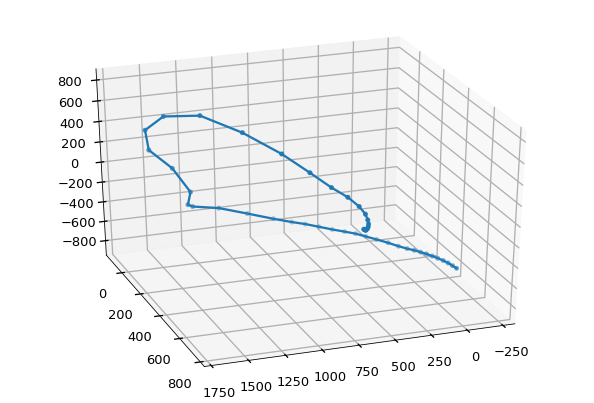

In [16]:
f = open('sample.txt','r')
d = f.read()
data = d.split('\n')
index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
real_data = []
for y in range(len(data)):
    if data[y]=='':
        continue
    real_data.append(data[y].split(','))
df = pd.DataFrame(real_data)
df.columns = index_li
for y in index_li:
    df[y] = pd.to_numeric(df[y],downcast='float')

plt.style.use('seaborn-talk')

fig = plt.figure()
ax = fig.add_subplot(111,projection='3d')
X = np.array(df['AX'])
Y = np.array(df['AY'])
Z = np.array(df['AZ'])
ax.scatter(X,Y,Z)
ax.plot(X,Y,Z)
ax.view_init(30, 70)
plt.show()

In [17]:
print(len(df))

47


In [21]:
for z in range(len(tmp_z)-1):
    bx=tmp_z[z]
    bx2=tmp_z[z+1]

    f = open('0104serial.txt','r')
    d = f.read()
    data = d.split('\n')
    index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
    real_data = []
    for y in range(len(data)):
        if data[y]=='':
            continue
        real_data.append(data[y].split(','))
    df = pd.DataFrame(real_data)
    df.columns = index_li
    for y in index_li:
        df[y] = pd.to_numeric(df[y],downcast='float')

    plt.style.use('seaborn-talk')

    fig = plt.figure()
    ax = fig.add_subplot(111,projection='3d')
    X = np.array(df['AX'][bx:bx2])
    Y = np.array(df['AY'][bx:bx2])
    Z = np.array(df['AZ'][bx:bx2])
    ax.scatter(X,Y,Z)
    ax.plot(X,Y,Z)
    plt.show()



In [22]:
f = open('0104-2.txt','r')
d = f.read()
data = d.split('\n')
index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
real_data = []
for y in range(len(data)):
    if data[y]=='':
        continue
    real_data.append(data[y].split(','))
df = pd.DataFrame(real_data)
df.columns = index_li
for y in index_li:
    df[y] = pd.to_numeric(df[y],downcast='float')


[123, 263, 379, 493, 616, 845, 965, 1079, 1185, 1287]


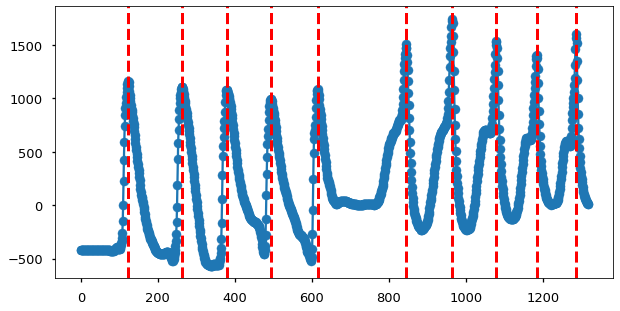

In [23]:
ind_li = []
for i in range(len(df)):
    ind_li.append(i)

Y = np.array(df['AX'])
X = np.array(ind_li)

tmp_li = []
for i in range(30,len(Y)-30):
    if Y[i-30]<Y[i-1] and Y[i-1]<Y[i] and Y[i]>Y[i+1] and Y[i+1]>Y[i+30]:
        tmp_li.append(i)
    
print(tmp_li)

plt.figure(figsize=(10,5))
plt.scatter(X,Y)
plt.plot(X,Y)

for i in tmp_li:
    plt.axvline(x=i, color='r', linestyle='--', linewidth=3)

plt.show()

tmp_x = tmp_li


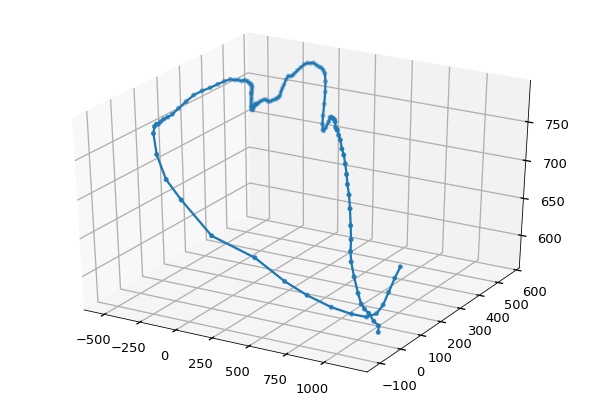

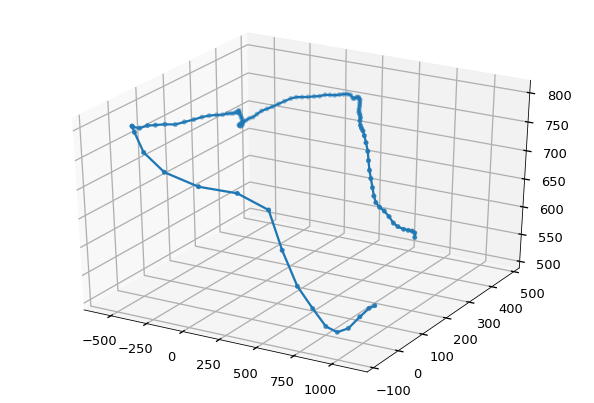

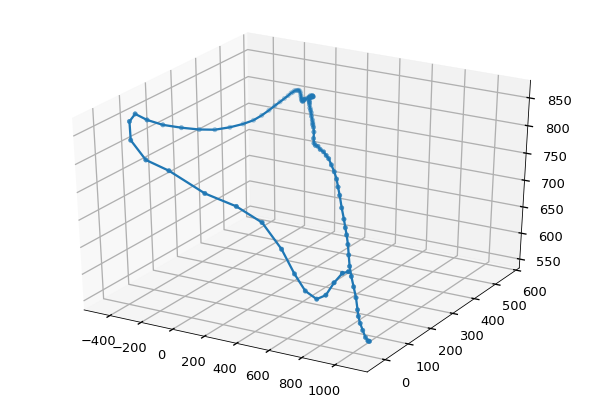

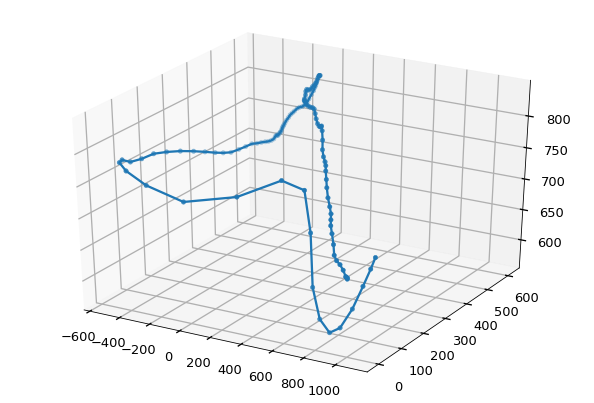

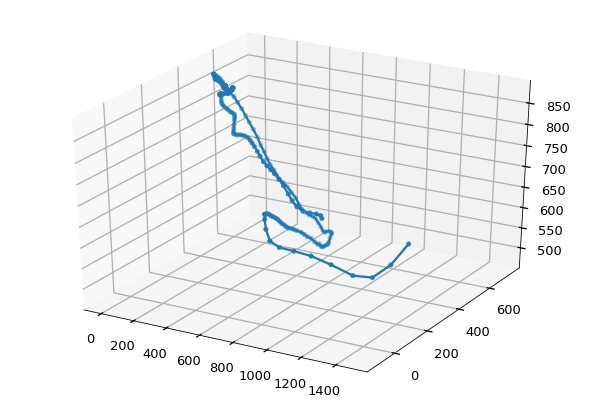

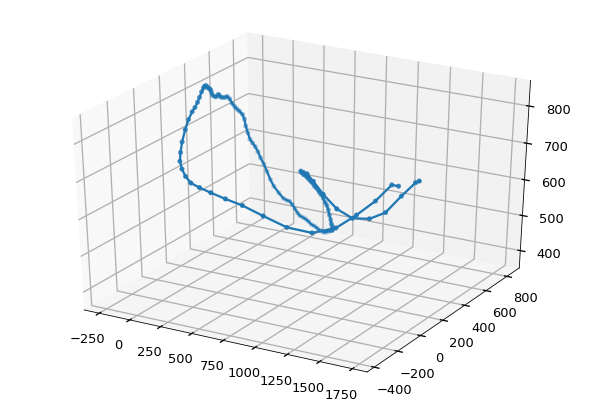

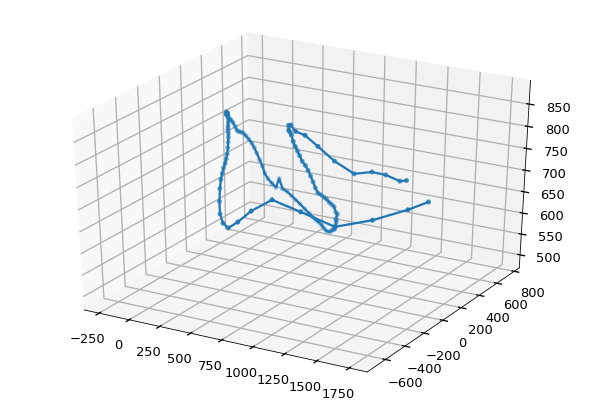

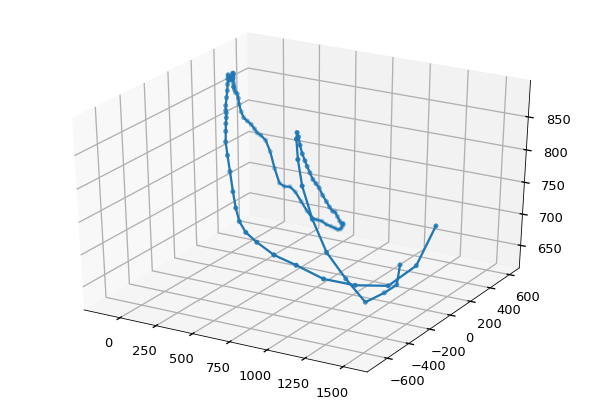

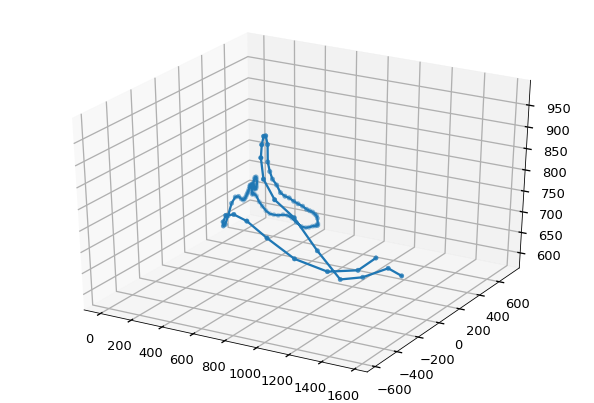

In [24]:
for z in range(len(tmp_x)-1):
    bx=tmp_x[z]
    bx2=tmp_x[z+1]

    f = open('0104-2.txt','r')
    d = f.read()
    data = d.split('\n')
    index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
    real_data = []
    for y in range(len(data)):
        if data[y]=='':
            continue
        real_data.append(data[y].split(','))
    df = pd.DataFrame(real_data)
    df.columns = index_li
    for y in index_li:
        df[y] = pd.to_numeric(df[y],downcast='float')

    plt.style.use('seaborn-talk')

    fig = plt.figure()
    ax = fig.add_subplot(111,projection='3d')
    X = np.array(df['AX'][bx:bx2])
    Y = np.array(df['AY'][bx:bx2])
    Z = np.array(df['AZ'][bx:bx2])
    ax.scatter(X,Y,Z)
    ax.plot(X,Y,Z)
    plt.show()


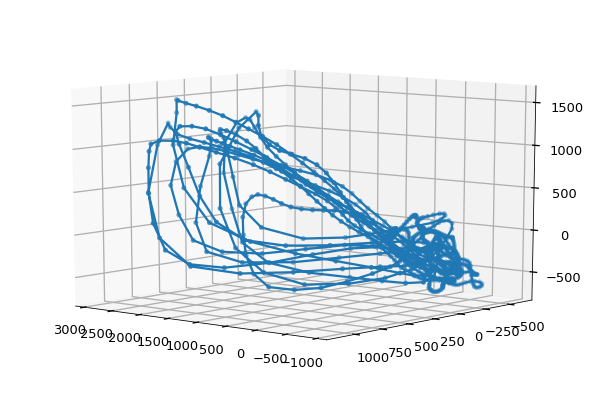

In [40]:
f = open('0104serial.txt','r')
d = f.read()
data = d.split('\n')
index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
real_data = []
for y in range(len(data)):
    if data[y]=='':
        continue
    real_data.append(data[y].split(','))
df = pd.DataFrame(real_data)
df.columns = index_li
for y in index_li:
    df[y] = pd.to_numeric(df[y],downcast='float')

plt.style.use('seaborn-talk')

fig = plt.figure()
ax = fig.add_subplot(111,projection='3d')
X = np.array(df['GX'])
Y = np.array(df['GY'])
Z = np.array(df['GZ'])
ax.scatter(X,Y,Z)
ax.plot(X,Y,Z)

ax.view_init(10, 130)

plt.show()

[32, 141, 232, 326, 416, 518, 610, 703, 794, 886, 970]


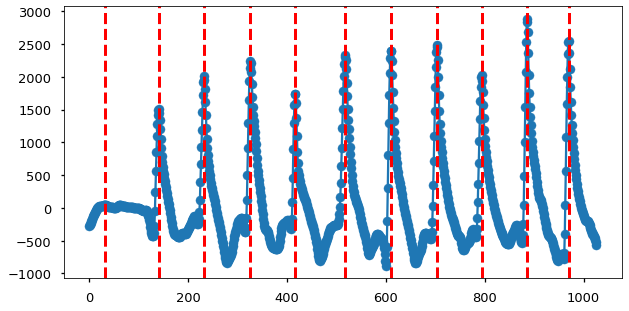

In [43]:
ind_li = []
for i in range(len(df)):
    ind_li.append(i)

Y = np.array(df['GX'])
X = np.array(ind_li)

tmp_li = []
for i in range(30,len(Y)-30):
    if Y[i-30]<Y[i-1] and Y[i-1]<Y[i] and Y[i]>Y[i+1] and Y[i+1]>Y[i+30]:
        tmp_li.append(i)
    
print(tmp_li)

plt.figure(figsize=(10,5))
plt.scatter(X,Y)
plt.plot(X,Y)

for i in tmp_li:
    plt.axvline(x=i, color='r', linestyle='--', linewidth=3)

plt.show()

tmp_x = tmp_li

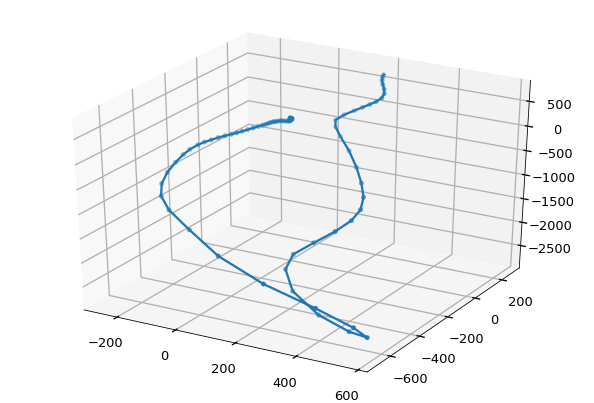

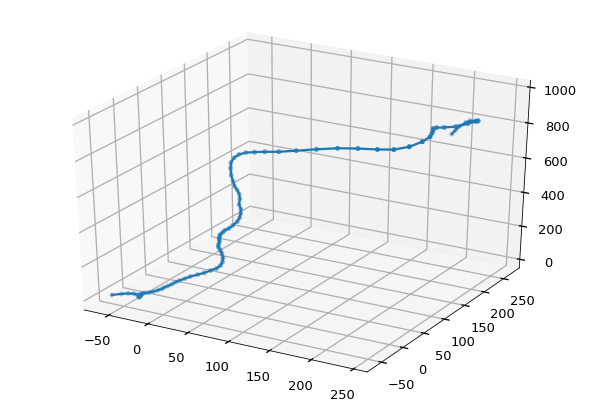

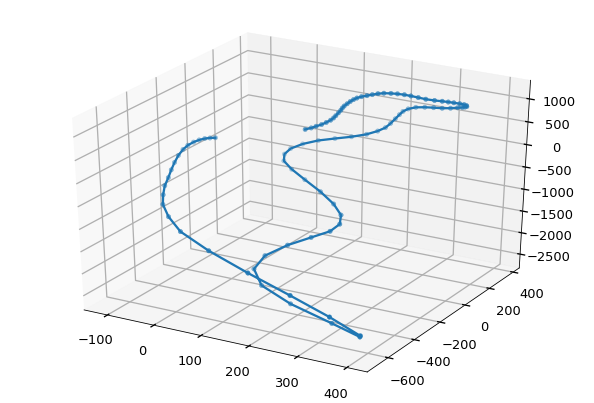

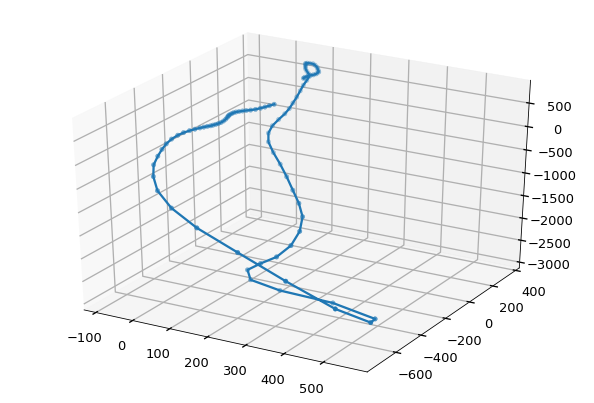

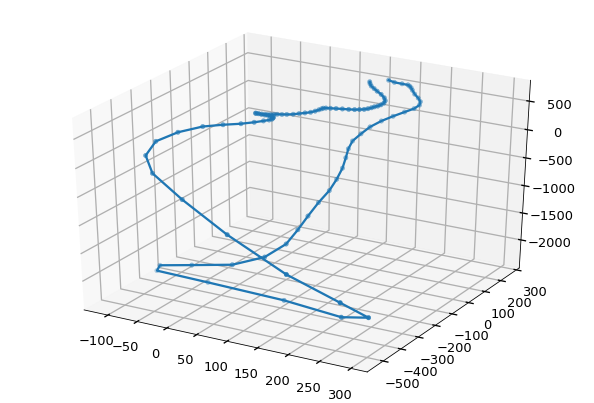

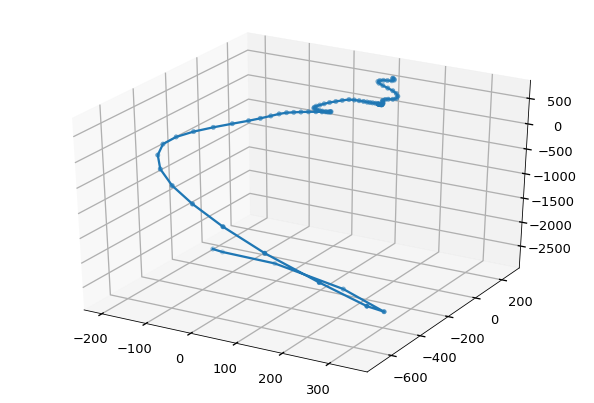

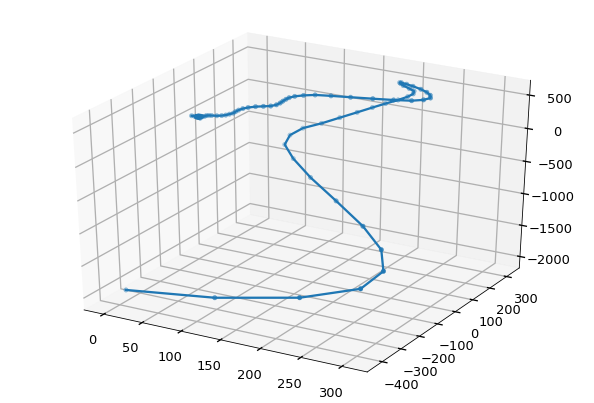

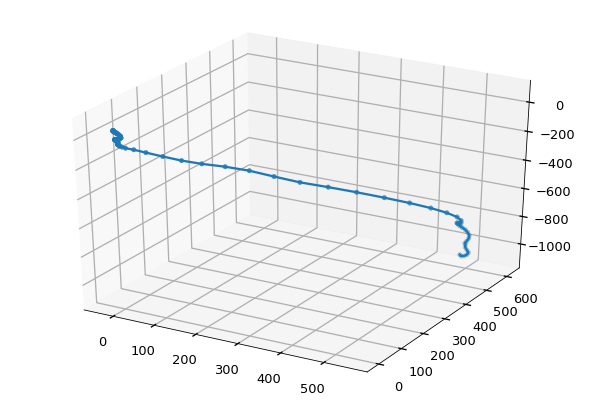

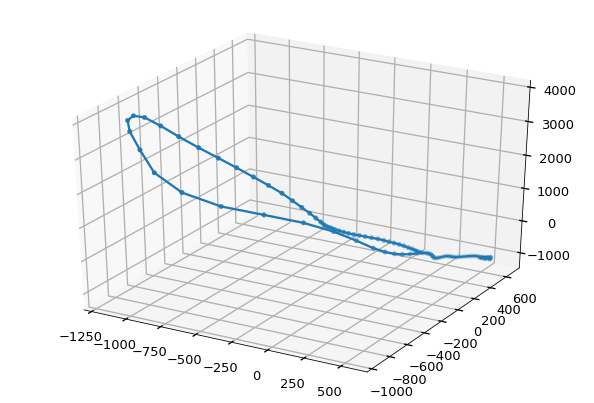

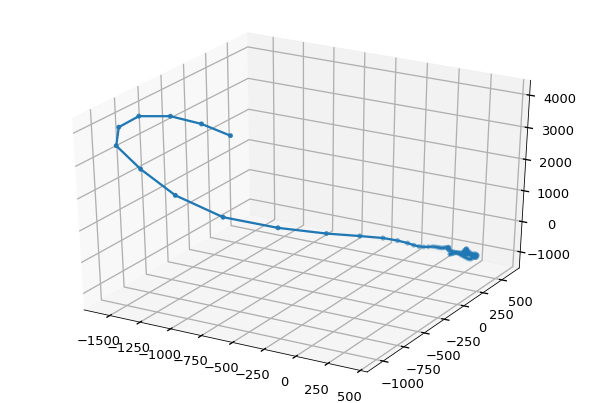

In [44]:
for z in range(len(tmp_x)-1):
    bx=tmp_x[z]
    bx2=tmp_x[z+1]

    f = open('0104-2.txt','r')
    d = f.read()
    data = d.split('\n')
    index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
    real_data = []
    for y in range(len(data)):
        if data[y]=='':
            continue
        real_data.append(data[y].split(','))
    df = pd.DataFrame(real_data)
    df.columns = index_li
    for y in index_li:
        df[y] = pd.to_numeric(df[y],downcast='float')

    plt.style.use('seaborn-talk')

    fig = plt.figure()
    ax = fig.add_subplot(111,projection='3d')
    X = np.array(df['GX'][bx:bx2])
    Y = np.array(df['GY'][bx:bx2])
    Z = np.array(df['GZ'][bx:bx2])
    ax.scatter(X,Y,Z)
    ax.plot(X,Y,Z)
    plt.show()

[72, 140, 231, 278, 322, 327, 412, 417, 513, 517, 606, 698, 703, 789, 793, 881, 886, 950, 965, 970]


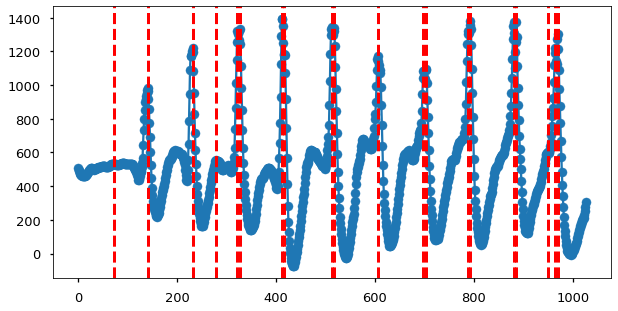

In [42]:
f = open('0104serial.txt','r')
d = f.read()
data = d.split('\n')
index_li = ['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ']
real_data = []
for y in range(len(data)):
    if data[y]=='':
        continue
    real_data.append(data[y].split(','))
df = pd.DataFrame(real_data)
df.columns = index_li
for y in index_li:
    df[y] = pd.to_numeric(df[y],downcast='float')
ind_li = []
for i in range(len(df)):
    ind_li.append(i)

Y = np.array(df['AX'])
X = np.array(ind_li)

tmp_li = []
for i in range(30,len(Y)-30):
    if Y[i-30]<Y[i-1] and Y[i-1]<Y[i] and Y[i]>Y[i+1] and Y[i+1]>Y[i+30]:
        tmp_li.append(i)
    
print(tmp_li)

plt.figure(figsize=(10,5))
plt.scatter(X,Y)
plt.plot(X,Y)

for i in tmp_li:
    plt.axvline(x=i, color='r', linestyle='--', linewidth=3)

plt.show()

tmp_x = tmp_li